In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True

import matplotlib.pyplot as plt

%matplotlib inline

data_path = "../../../TabulaSapiensData/"
organ = "Pancreas"
organ_adata = read_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.oct2020.h5ad" % organ
)

def FilterDE(de, cluster):
    is_MT = np.asarray(
        [
            (
                x.startswith("MT")
                or x.startswith("RP")
                or x.startswith("AC")
                or x.startswith("AL")
                or x.startswith("EEF")
            )
            for x in de[cluster].T.index
        ]
    )
    return de[cluster].T.loc[~is_MT][:20]

<IPython.core.display.Javascript object>

In [122]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

<IPython.core.display.Javascript object>

INFO      Training time:  203 s. / 300 epochs                                                


/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


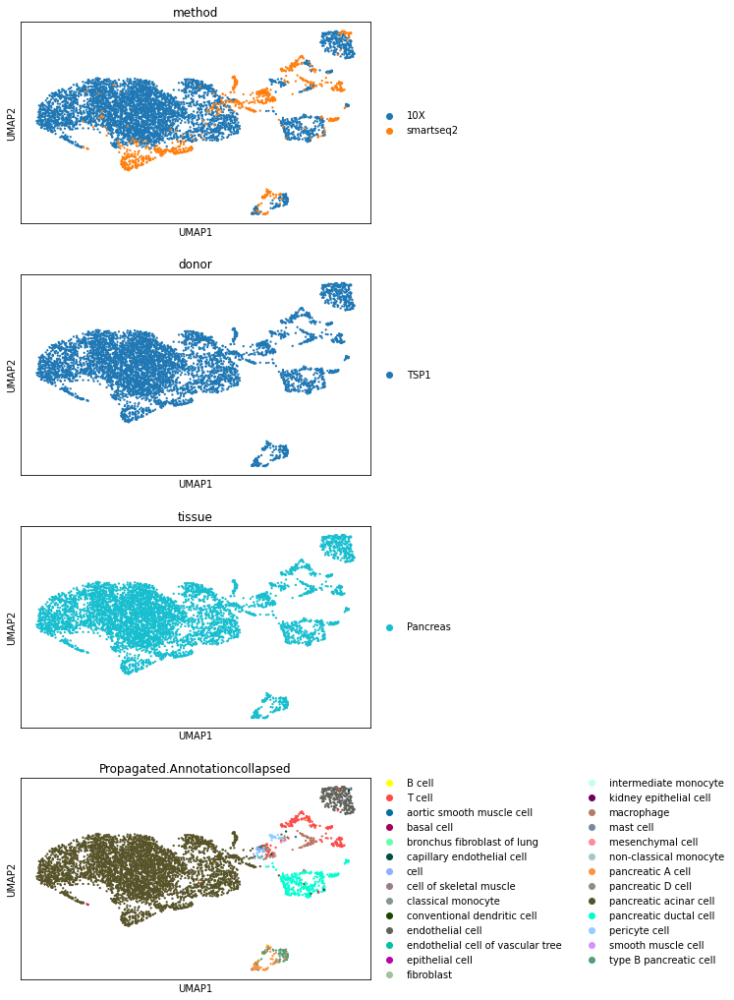

<IPython.core.display.Javascript object>

In [78]:
# adata = organ_adata.copy()
# adata.layers["raw_counts"] = np.round(np.expm1(organ_adata.X))
# adata.X = adata.layers["raw_counts"].copy()
# sc.pp.normalize_total(adata, target_sum=1e4)
# sc.pp.log1p(adata)
# sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
# adata = adata[:, adata.var.highly_variable]

# adata.X = adata.layers["raw_counts"]
# adata = adata.copy()

# scvi.data.setup_anndata(adata, batch_key="donor_method")
# vae1 = scvi.model.SCVI(
#     adata, n_layers=2, n_latent=50, dispersion="gene-batch", use_cuda=True
# )

# vae1.train(n_epochs=300, n_epochs_kl_warmup=100)

# organ_adata.obsm["X_scvi_decontX"] = vae1.get_latent_representation()
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.leiden(organ_adata)
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "tissue", "Propagated.Annotationcollapsed"],
    ncols=1,
)

In [79]:
sc.tl.leiden(organ_adata, resolution=0.5, key_added="leiden")

<IPython.core.display.Javascript object>

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [80]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

<IPython.core.display.Javascript object>

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

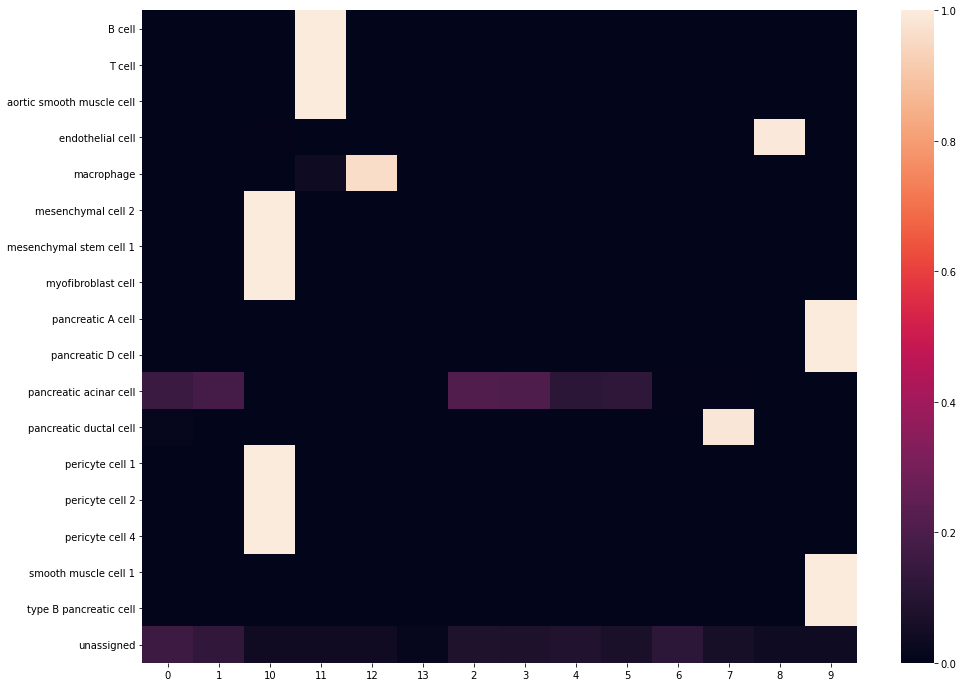

<IPython.core.display.Javascript object>

In [81]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.sum(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [82]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

<IPython.core.display.Javascript object>

In [83]:
cluster_composition["0"]

['pancreatic acinar cell: 0.47',
 'pancreatic ductal cell: 0.00',
 'unassigned: 0.52']

<IPython.core.display.Javascript object>

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [84]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

<IPython.core.display.Javascript object>

In [85]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-84-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


<IPython.core.display.Javascript object>

In [86]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


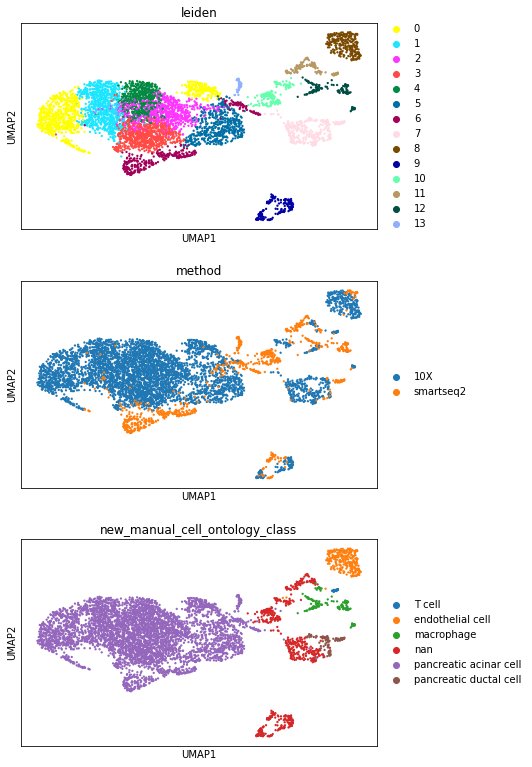

<IPython.core.display.Javascript object>

In [87]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "method", "new_manual_cell_ontology_class"],
    ncols=1,
)

In [88]:
organ_adata.obs.groupby(["leiden"]).agg(
    {"new_manual_cell_ontology_class": set, "Propagated.Annotation": set}
)

,new_manual_cell_ontology_class,Propagated.Annotation
leiden,,
0,{pancreatic acinar cell},"{T cell, epithelial cell, pancreatic acinar cell}"
1,{pancreatic acinar cell},{pancreatic acinar cell}
2,{pancreatic acinar cell},"{pancreatic D cell, pancreatic A cell, pancrea..."
3,{pancreatic acinar cell},"{T cell, pancreatic acinar cell}"
4,{pancreatic acinar cell},{pancreatic acinar cell}
5,{pancreatic acinar cell},"{T cell, pancreatic acinar cell}"
6,{pancreatic acinar cell},{pancreatic acinar cell}
7,"{pancreatic acinar cell, pancreatic ductal cel...","{kidney epithelial cell, epithelial cell, T ce..."
8,{endothelial cell},"{T cell, capillary endothelial cell, CD8-posit..."


<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


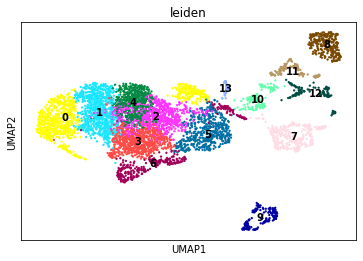

<IPython.core.display.Javascript object>

In [89]:
sc.pl.umap(organ_adata, color="leiden", legend_loc="on data")

# visualize compartment markers

In [91]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future 

<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


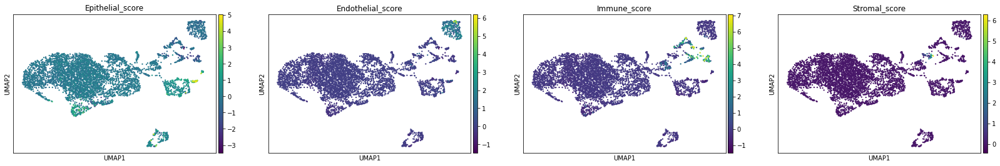

<IPython.core.display.Javascript object>

In [92]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# read in cell ontology 

In [93]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



<IPython.core.display.Javascript object>

You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [94]:
celltype_dict["T cell"]

'CL:0000084'

<IPython.core.display.Javascript object>

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [95]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


# PrintChildren(co, "T cell", "CD4")

<IPython.core.display.Javascript object>

# Find markers for each cluster

In [96]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

<IPython.core.display.Javascript object>

In [97]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


<IPython.core.display.Javascript object>

In [98]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

<IPython.core.display.Javascript object>

### top positive marker genes

In [99]:
organ_cluster_genes = pd.DataFrame(organ_adata.uns['rank_genes_groups']['names'])
organ_cluster_genes.iloc[:20]


,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,LENG8,CEL,SCG5,PRSS2,PRSS3,AC093765.1,AL590556.3,SLC4A4,SPARCL1,TTR,MALAT1,CD52,TMSB4X,AL512646.1
1,MT-ND3,RPL9P9,FGL1,CTRL,CTRL,SUPT16HP1,PNLIPRP1,ANXA4,FABP5,CPE,IFITM2,CD74,S100A6,MT-ATP8
2,AC009078.2,CTRL,LINC00632,PLA2G1B,CEL,AC018641.1,CELA3A,CFTR,PLVAP,SCG3,AL512646.1,TMSB4X,ACTB,RPL6P27
3,RPL9P9,KLK1,AC011008.2,AMY2A,CLPS,AC015922.1,PNLIPRP2,ATP1B1,IFI27,CHGB,S100A9,B2M,DUSP1,RPL3P4
4,PGGHG,CPA1,HMGCS2,CELA2B,PRSS1,Z98752.2,AC009078.2,ANXA2,PECAM1,SCG5,NAMPT,ARHGDIB,FCER1G,RPL21P28
5,RPL41P2,SYCN,AL162377.3,CEL,PRSS2,RN7SKP40,FP671120.5,ATP1A1,RAMP2,SCG2,SAT1,ACTB,B2M,CELA2A
6,PCBP2,GP2,AC004241.3,CTRB2,SERPINI2,FAM9B,GP2,S100A10,IGFBP4,PCSK1N,CSF3R,HLA-DRA,CAPG,AC113935.1
7,PACSIN2,CTRC,VDAC1P6,CELA3B,RNASE1,BTBD11,PDIA2,SPP1,A2M,NEUROD1,SPARCL1,VPREB3,TMSB10,MT-ND6
8,PABPC4,PNLIP,DCST2,CTRC,CTRB1,AL031779.1,RBPJL,CITED4,TGFBR2,SCGN,MFGE8,CXCR4,ARHGDIB,CASP9
9,BCAT1,CPB1,ANKRD20A8P,CELA2A,PRDX4,AL512343.2,CPA2,DCDC2,GNG11,PCSK2,TPM2,RAC2,S100A11,RPL13AP5


<IPython.core.display.Javascript object>

In [100]:
a, b = np.unique(organ_adata.obs.manual_annotation, return_counts=True)
pd.DataFrame([a, b])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,B cell,T cell,aortic smooth muscle cell,endothelial cell,macrophage,mesenchymal cell 2,mesenchymal stem cell 1,myofibroblast cell,pancreatic A cell,pancreatic D cell,pancreatic acinar cell,pancreatic ductal cell,pericyte cell 1,pericyte cell 2,pericyte cell 4,smooth muscle cell 1,type B pancreatic cell,unassigned
1,1,18,1,178,27,3,1,1,23,12,2587,130,2,29,6,2,32,2698


<IPython.core.display.Javascript object>

In [101]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
LENG8,22.621267,1.566628,7.879205e-109
MT-ND3,21.040861,1.784761,5.441466e-94
AC009078.2,19.614737,1.664561,1.703359e-81
RPL9P9,19.022099,1.168335,1.317690e-76
PGGHG,18.782545,1.052648,1.029529e-74
RPL41P2,18.746193,1.318068,1.748931e-74
PCBP2,18.277828,1.063815,9.145239e-71
PACSIN2,18.152235,1.155936,8.063910e-70
PABPC4,18.037813,1.092839,5.790469e-69
BCAT1,17.903383,1.087399,5.939019e-68


1


,wilcoxon_score,log fold change,adjusted pvalue
CEL,31.817406,3.277756,2.189426e-217
RPL9P9,29.250679,1.847859,1.295680e-183
CTRL,29.058580,2.571217,2.352605e-181
KLK1,28.391359,2.592868,3.804723e-173
CPA1,28.289257,3.267457,4.655035e-172
SYCN,28.288815,3.215556,4.655035e-172
GP2,28.197241,3.090023,5.316326e-171
CTRC,28.041906,3.042921,3.689635e-169
PNLIP,27.939167,3.343006,5.340772e-168
CPB1,27.938587,3.287727,5.340772e-168


2


,wilcoxon_score,log fold change,adjusted pvalue
SCG5,1.146107,-0.851315,1.0
FGL1,1.120793,-0.322825,1.0
LINC00632,0.485339,-0.174281,1.0
AC011008.2,0.243789,1.647087,1.0
HMGCS2,0.216060,-0.272142,1.0
AL162377.3,0.172370,0.895912,1.0
AC004241.3,0.172089,0.368570,1.0
VDAC1P6,0.167483,1.170414,1.0
DCST2,0.167425,0.685079,1.0
ANKRD20A8P,0.159819,-0.003856,1.0


3


,wilcoxon_score,log fold change,adjusted pvalue
PRSS2,21.579294,3.033330,1.655017e-98
CTRL,20.821058,1.976578,8.211071e-92
PLA2G1B,20.377333,2.642261,5.214766e-88
AMY2A,20.224777,1.686330,8.721173e-87
CELA2B,19.941097,2.251646,2.108676e-84
CEL,19.503567,2.524142,1.004604e-80
CTRB2,19.469627,2.434391,1.671157e-80
CELA3B,19.081842,1.906489,2.630311e-77
CTRC,18.852806,2.510643,1.822762e-75
CELA2A,18.796143,2.099322,4.780907e-75


4


,wilcoxon_score,log fold change,adjusted pvalue
PRSS3,15.338547,1.925811,2.487548e-48
CTRL,15.229542,1.718361,6.627665e-48
CEL,15.185885,2.397687,8.606749e-48
CLPS,14.601934,2.769470,4.017676e-44
PRSS1,14.136335,2.756787,2.670225e-41
PRSS2,13.722963,2.504230,7.258578e-39
SERPINI2,13.611111,1.174913,2.892833e-38
RNASE1,13.590263,1.220997,3.366106e-38
CTRB1,13.553638,2.426545,4.931896e-38
PRDX4,13.536239,0.844039,5.625522e-38


5


,wilcoxon_score,log fold change,adjusted pvalue
AC093765.1,0.147055,21.387569,1.0
SUPT16HP1,0.139961,4.375605,1.0
AC018641.1,0.132896,3.746236,1.0
AC015922.1,0.125732,1.314505,1.0
Z98752.2,0.118681,1.838334,1.0
RN7SKP40,0.118597,0.936179,1.0
FAM9B,0.111504,1.079965,1.0
BTBD11,0.102420,-0.053656,1.0
AL031779.1,0.090153,0.751709,1.0
AL512343.2,0.083410,2.900999,1.0


6


,wilcoxon_score,log fold change,adjusted pvalue
AL590556.3,27.312096,10.860703,1.793882e-159
PNLIPRP1,26.925566,6.740705,3.245653e-155
CELA3A,26.515669,8.657290,1.254752e-150
PNLIPRP2,26.205536,6.894330,3.382237e-147
AC009078.2,26.109835,5.291434,3.319333e-146
FP671120.5,26.094509,7.276405,4.129171e-146
GP2,26.056742,6.696061,9.489504e-146
PDIA2,25.549389,5.944626,4.104058e-140
RBPJL,25.366014,5.783311,3.913869e-138
CPA2,25.304237,6.587682,1.689012e-137


7


,wilcoxon_score,log fold change,adjusted pvalue
SLC4A4,28.544741,10.826435,1.472159e-174
ANXA4,28.524321,9.077560,1.472159e-174
CFTR,28.515614,11.805353,1.472159e-174
ATP1B1,28.298965,7.538467,5.237389e-172
ANXA2,28.129269,7.727161,5.059925e-170
ATP1A1,27.930954,7.253457,1.102028e-167
S100A10,27.451658,6.736090,5.582454e-162
SPP1,27.374159,8.739731,4.099409e-161
CITED4,27.233925,8.804628,1.685367e-159
DCDC2,27.053745,8.904636,2.031582e-157


8


,wilcoxon_score,log fold change,adjusted pvalue
SPARCL1,27.260519,9.519460,7.341870e-159
FABP5,26.954510,9.254106,1.486623e-155
PLVAP,26.891533,13.463223,5.413588e-155
IFI27,26.857197,11.256381,1.022936e-154
PECAM1,26.804752,9.505696,3.348795e-154
RAMP2,26.535257,10.397628,3.728662e-151
IGFBP4,26.370296,9.219315,2.526006e-149
A2M,26.284559,7.723106,2.119162e-148
TGFBR2,26.251451,6.863142,4.068240e-148
GNG11,26.251284,6.915267,4.068240e-148


9


,wilcoxon_score,log fold change,adjusted pvalue
TTR,21.790991,17.459335,1.662909e-100
CPE,21.516739,10.781309,3.194680e-98
SCG3,21.393398,17.170847,3.020585e-97
CHGB,20.860069,15.820870,1.817487e-92
SCG5,20.752739,9.319422,1.363489e-91
SCG2,20.197359,18.025986,1.013308e-86
PCSK1N,20.061886,16.006308,1.336695e-85
NEUROD1,19.932003,33.526093,1.580600e-84
SCGN,19.922369,6.146921,1.703158e-84
PCSK2,19.796434,14.655517,1.780043e-83


10


,wilcoxon_score,log fold change,adjusted pvalue
MALAT1,12.175735,4.391640,6.751657e-32
IFITM2,10.311674,3.825210,6.184776e-23
AL512646.1,9.865360,3.061340,5.230998e-21
S100A9,9.482474,8.768426,2.002572e-19
NAMPT,8.096890,3.675723,3.090495e-14
SAT1,7.797998,3.323708,3.181047e-13
CSF3R,6.742649,7.885304,5.906935e-10
SPARCL1,6.721241,3.533116,6.799620e-10
MFGE8,6.253170,6.370202,1.331701e-08
TPM2,5.862114,5.879482,1.361545e-07


11


,wilcoxon_score,log fold change,adjusted pvalue
CD52,16.941879,11.052879,7.651403e-61
CD74,16.330603,9.710694,1.099977e-56
TMSB4X,15.738707,6.550288,1.239352e-52
B2M,15.246716,5.977210,2.123299e-49
ARHGDIB,14.696655,7.292226,6.535844e-46
ACTB,14.258852,5.965866,3.469801e-43
HLA-DRA,13.271617,8.442661,2.315113e-37
VPREB3,13.209981,12.007267,5.140704e-37
CXCR4,12.796308,8.908390,1.065452e-34
RAC2,12.712639,7.277360,3.022052e-34


12


,wilcoxon_score,log fold change,adjusted pvalue
TMSB4X,17.901180,7.610402,4.517959e-67
S100A6,17.885313,9.185949,4.517959e-67
ACTB,17.516438,8.044977,2.106369e-64
DUSP1,17.316971,8.301661,5.155818e-63
FCER1G,16.905107,14.080602,3.025622e-60
B2M,16.843523,6.935621,4.594006e-60
CAPG,16.696907,9.748703,4.063138e-59
TMSB10,16.628582,5.973086,1.061411e-58
ARHGDIB,16.443987,10.471170,1.758884e-57
S100A11,16.140841,7.791407,2.178190e-55


13


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,9.550732,5.472135,1.083073e-17
MT-ATP8,9.345078,5.455441,6.756986e-17
RPL6P27,8.825495,3.451963,5.832247e-15
RPL3P4,8.716026,4.306820,1.413553e-14
RPL21P28,8.430289,3.985005,1.068373e-13
CELA2A,8.342991,3.658472,1.938282e-13
AC113935.1,8.315134,3.658799,2.345801e-13
MT-ND6,7.956100,2.379962,3.818904e-12
CASP9,7.821545,3.493727,9.599262e-12
RPL13AP5,7.706056,2.090925,2.064677e-11


<IPython.core.display.Javascript object>

0


/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


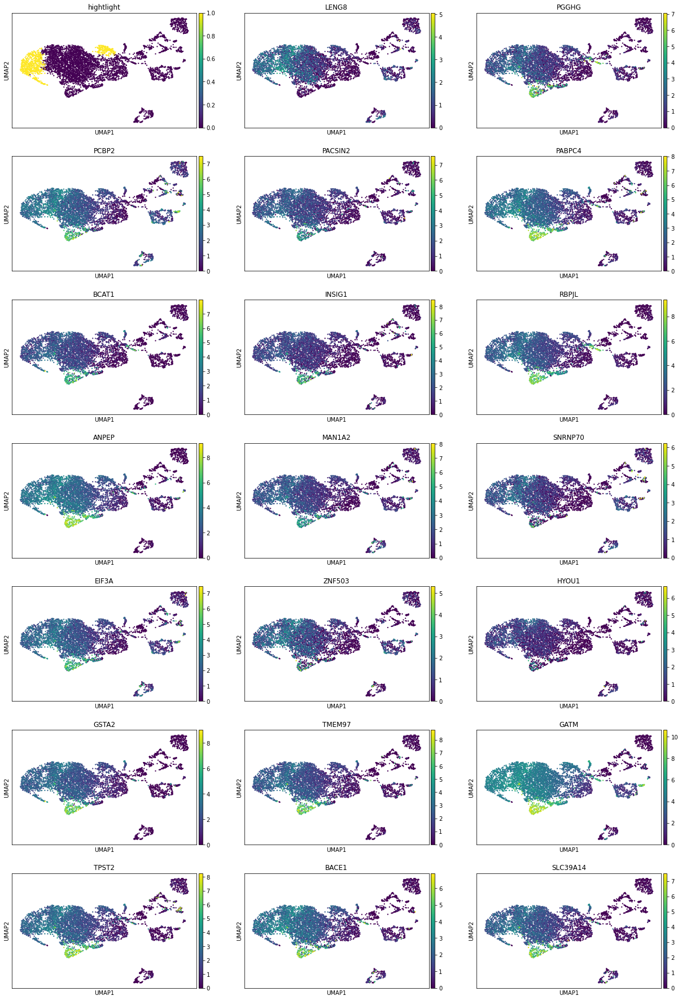

1


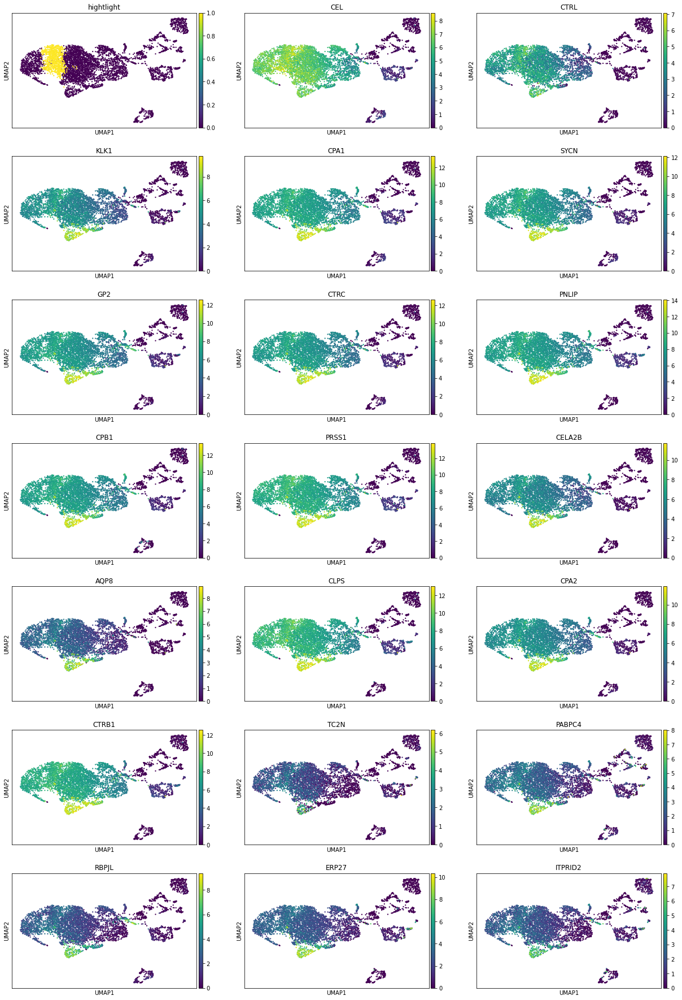

2


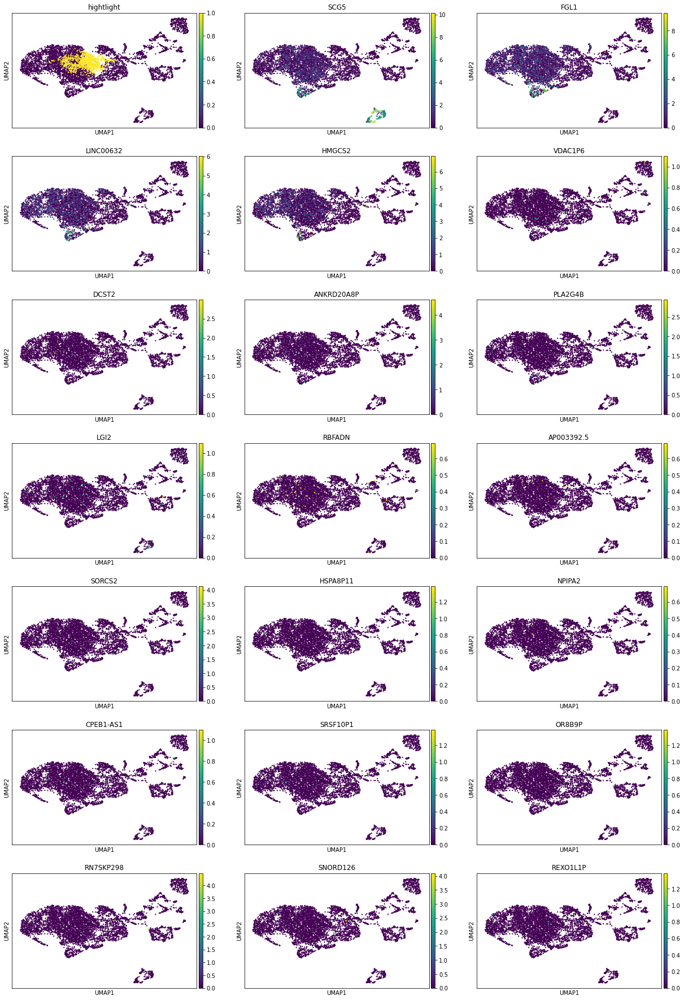

3


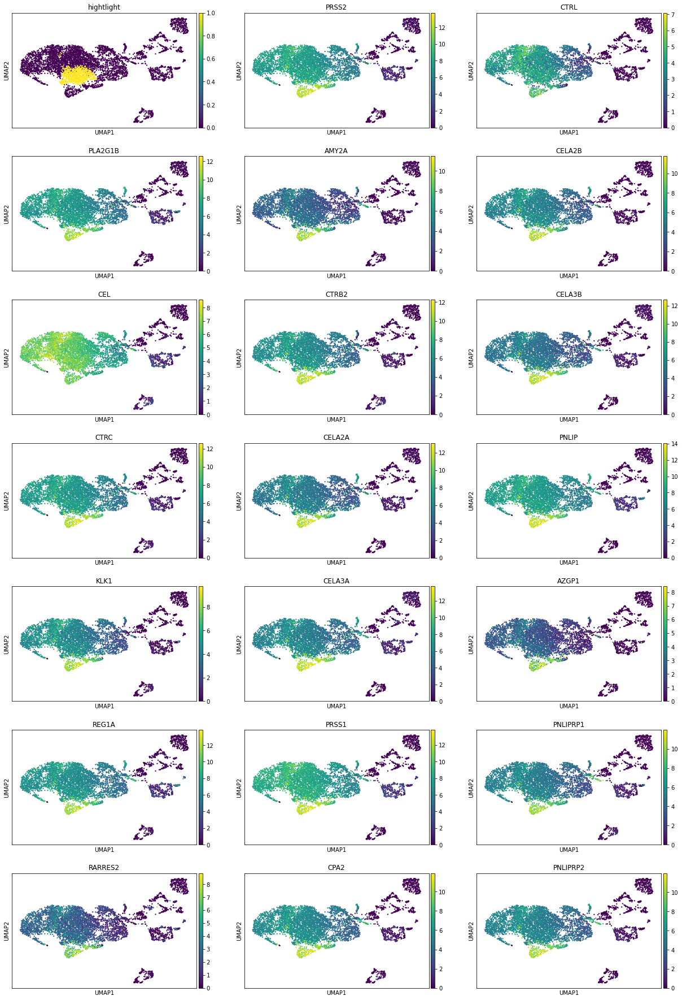

4


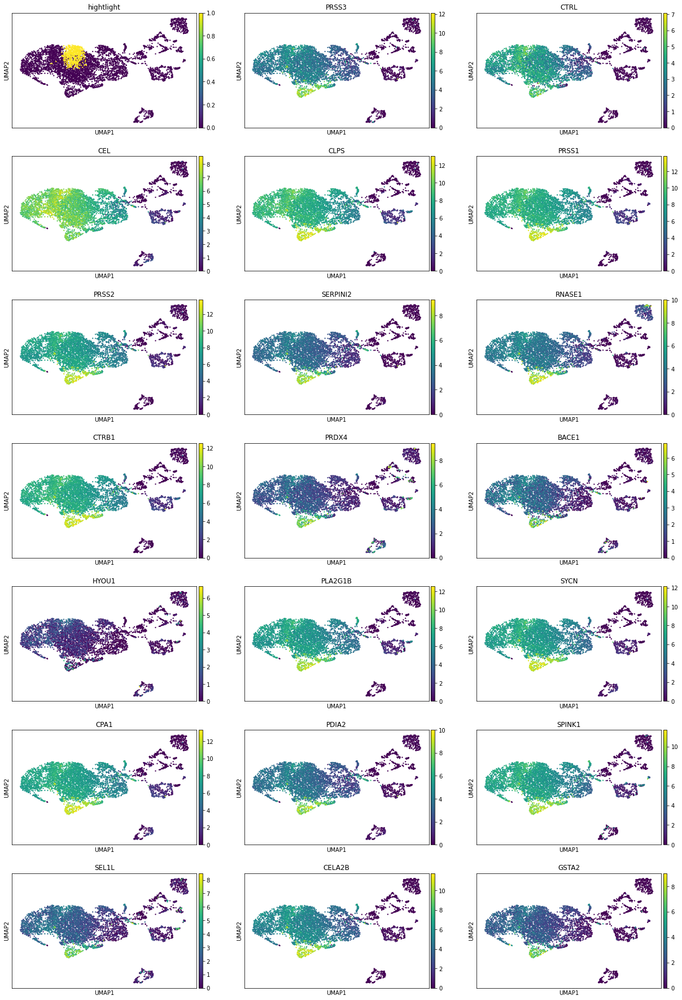

5


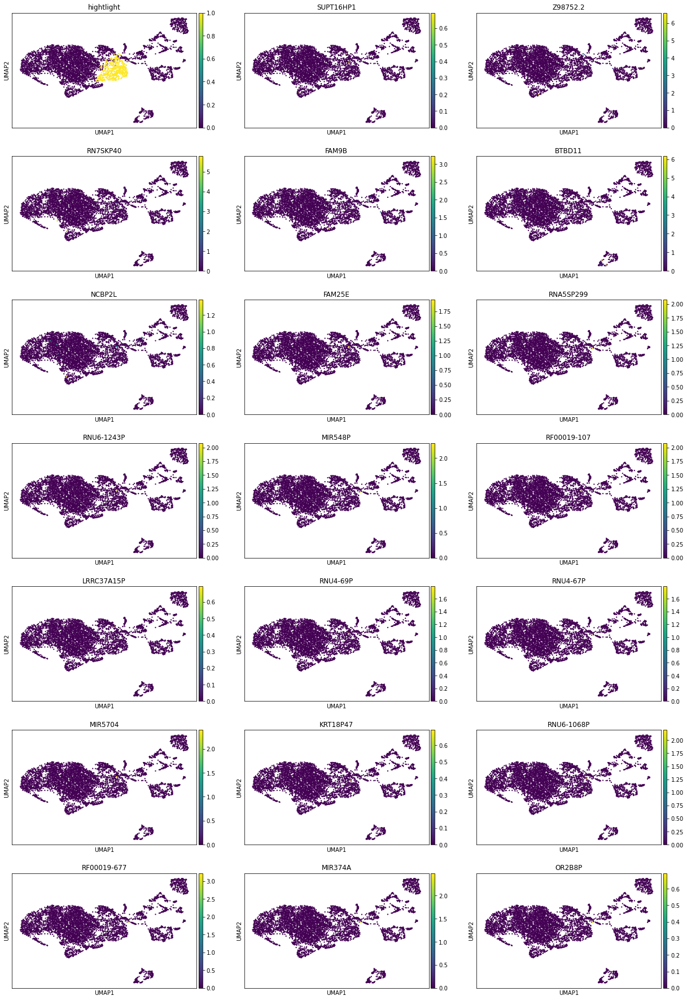

6


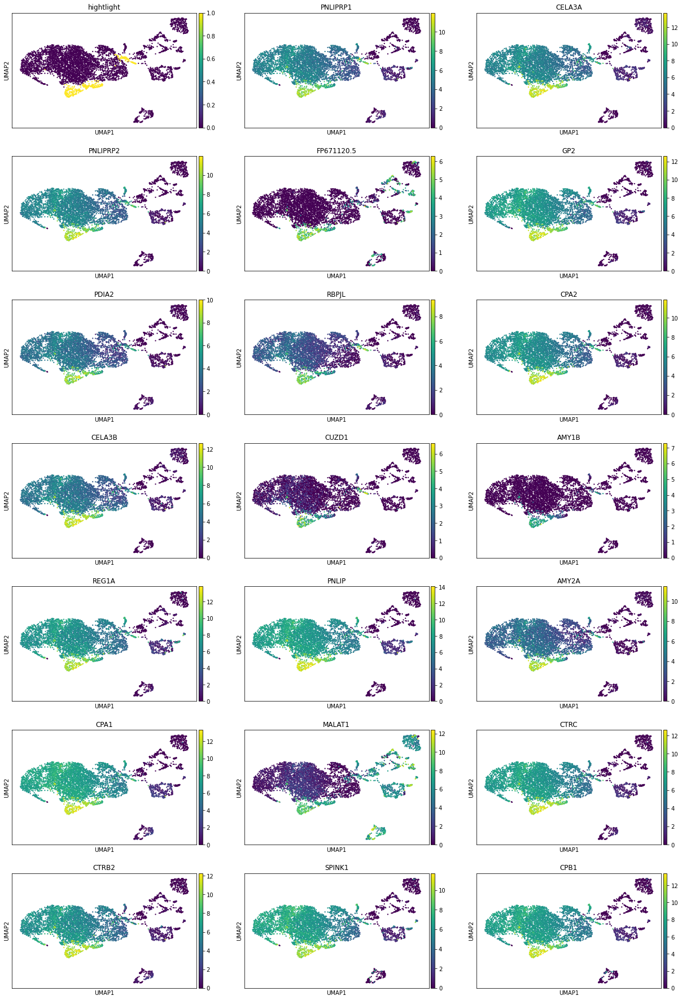

7


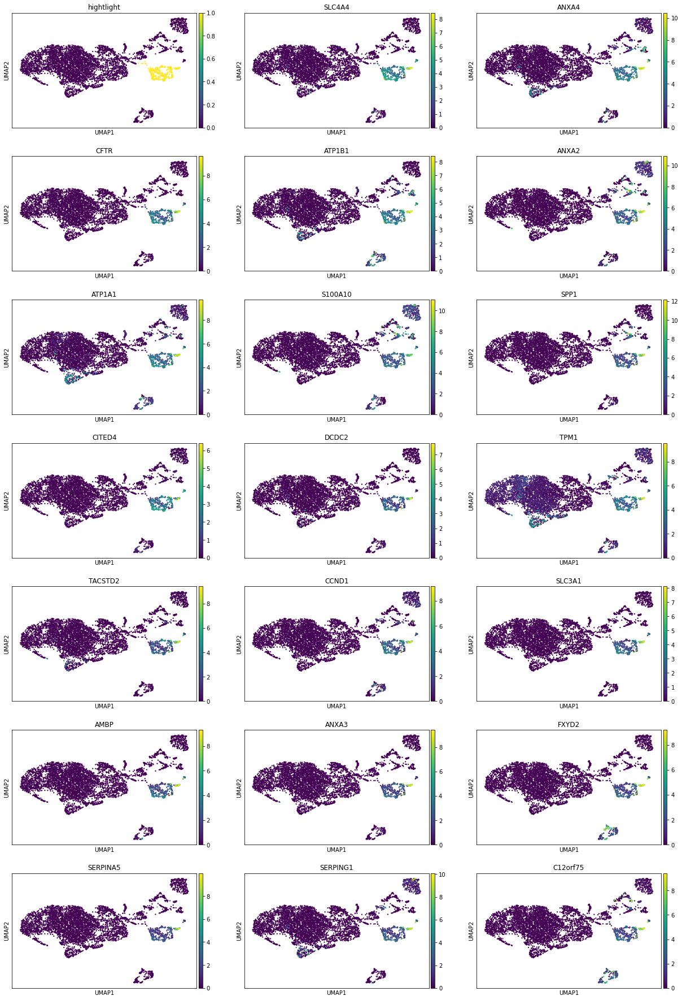

8


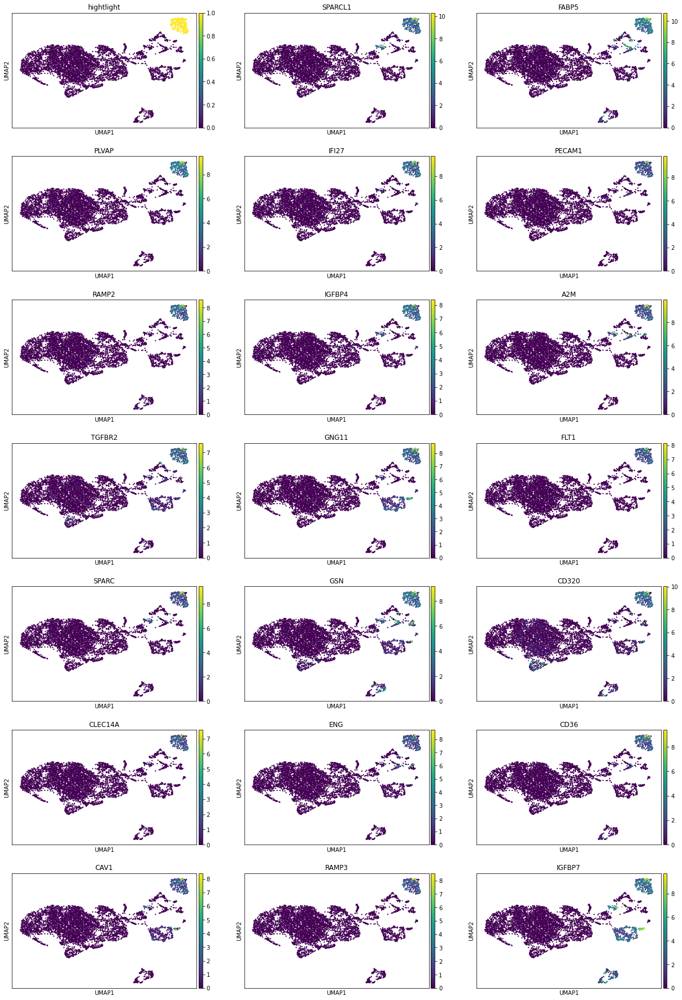

9


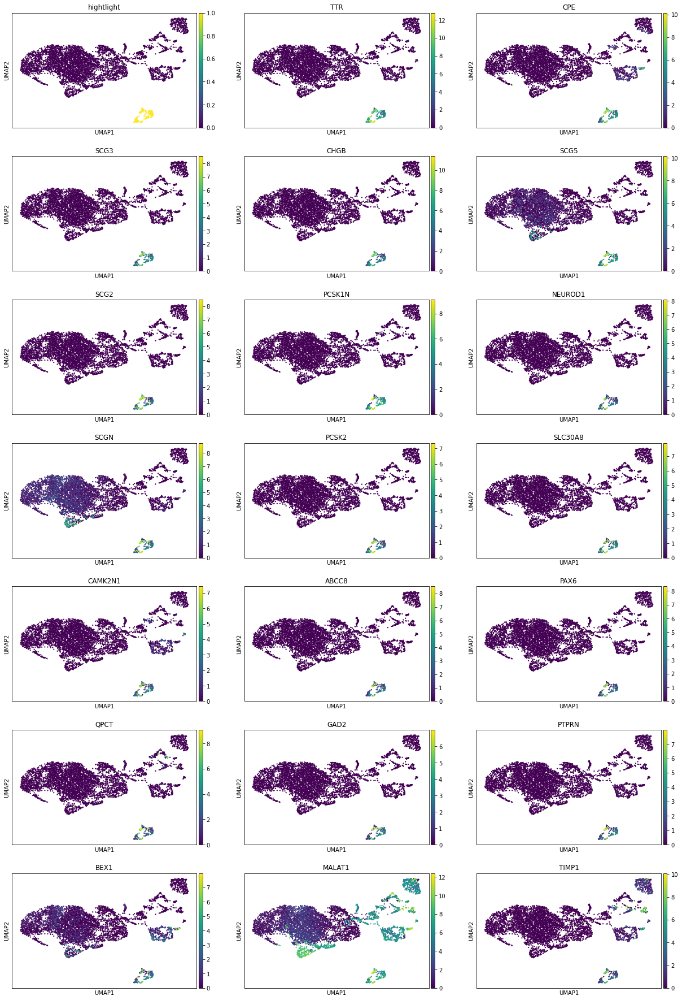

10


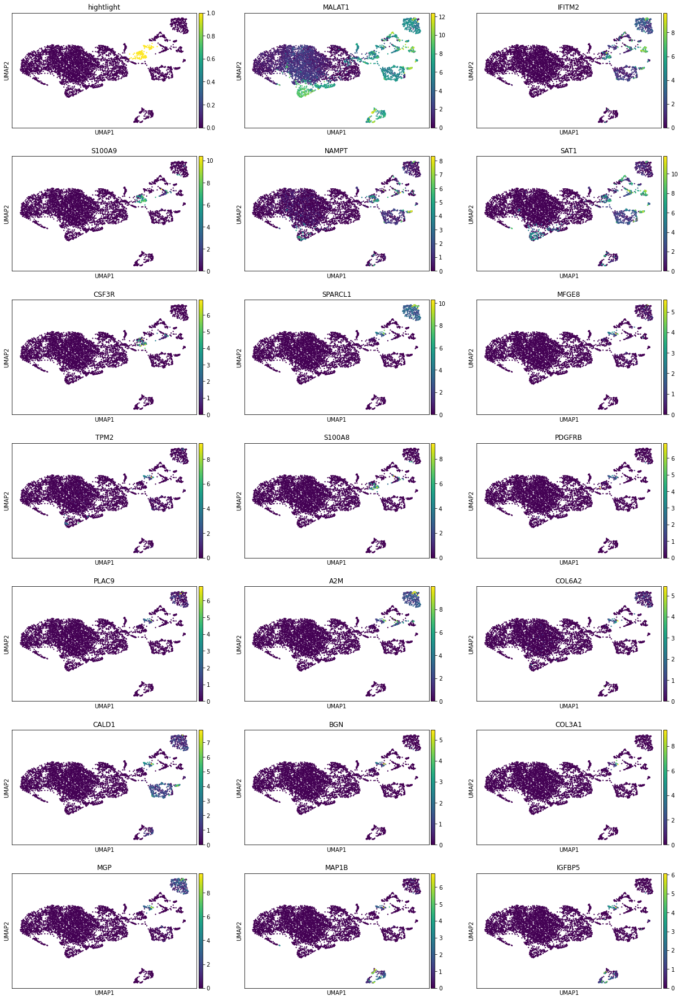

11


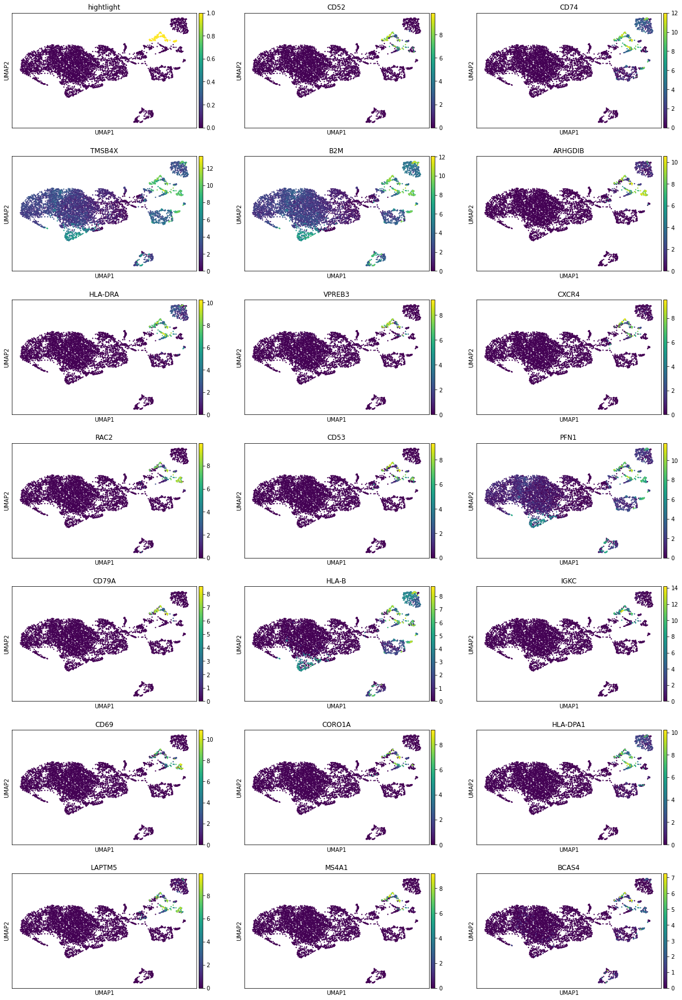

12


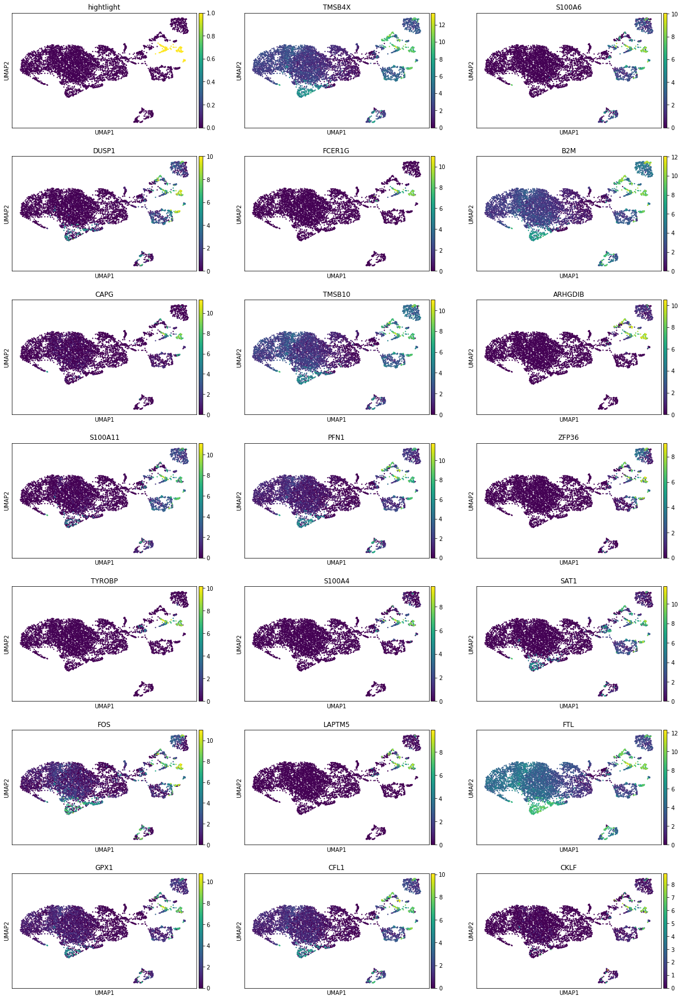

13


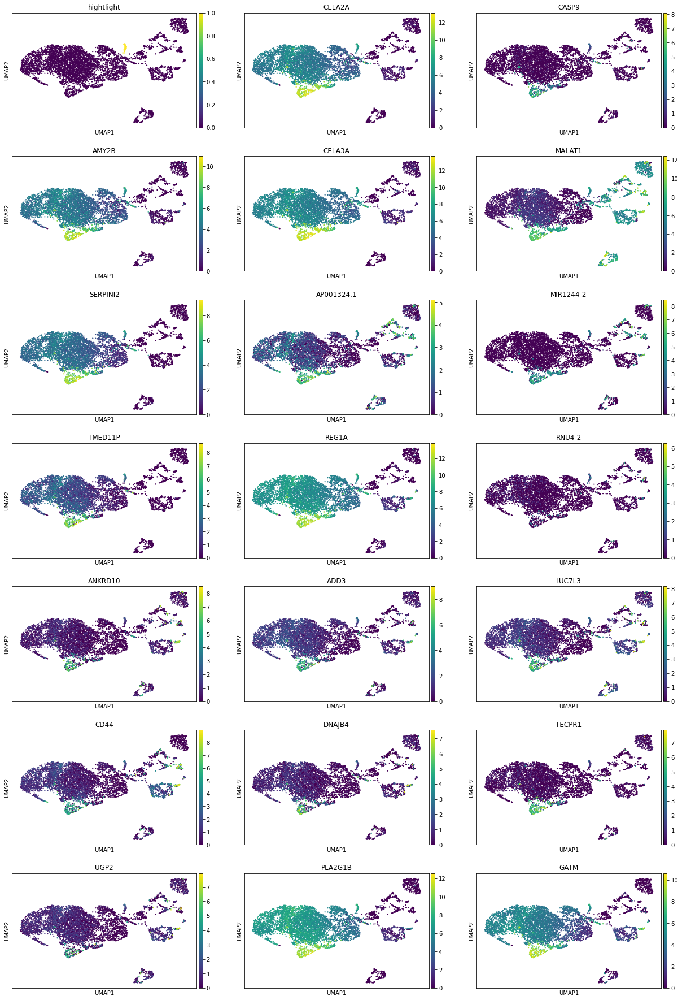

<IPython.core.display.Javascript object>

In [102]:
for x in DE.keys():
    print(x)
    topgenes = list(FilterDE(DE, x).index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### Plot known marker genes

In [125]:
for x in DE.keys():
    print(x)
    #     display(DE[x].T.loc[["AMY2A", "CPA1", "CPB1", "PRSS1", "RBPJL", "PTF1A", "GP2"]]) # acinar
    #     display(DE[x].T.loc[["KRT19", "KRT18", "MUC1", "SPP1", "BICC1", "SOX9"]]) # ductal
    #     display(DE[x].T.loc[["KRT19", "SOX9", "HNF1B"]]) # centroacinar
    #     display(DE[x].T.loc[["INS", "NKX6-1", "SIX3", "MAFA", "OLIG1",]]) # beta
    #     display(DE[x].T.loc[compartment_markers["Immune"]])
    #     display(DE[x].T.loc[compartment_markers["Endothelial"]])
#     display(DE[x].T.loc[compartment_markers["Stromal"]])


0


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.376486,-23.573111,1.0
DCN,-0.329425,-23.727175,1.0
COL1A2,-0.338837,-23.765564,1.0


1


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.372521,-23.568687,1.0
DCN,-0.325956,-23.722750,1.0
COL1A2,-0.335269,-23.761139,1.0


2


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.356741,-23.551422,1.0
DCN,-0.312149,-23.705473,1.0
COL1A2,-0.321067,-23.743858,1.0


3


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.350774,-23.545038,1.0
DCN,-0.306928,-23.699083,1.0
COL1A2,-0.315697,-23.737467,1.0


4


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.293767,-23.488249,1.0
DCN,-0.257046,-23.642258,1.0
COL1A2,-0.264391,-23.680632,1.0


5


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.283736,-23.479090,1.0
DCN,-0.248269,-23.633093,1.0
COL1A2,-0.255362,-23.671465,1.0


6


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.228629,-23.433613,1.0
DCN,-0.200051,-23.587585,1.0
COL1A2,-0.205766,-23.625950,1.0


7


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.218420,-23.426126,1.0
DCN,-0.090441,-2.475751,1.0
COL1A2,-0.196578,-23.618456,1.0


8


,wilcoxon_score,log fold change,adjusted pvalue
BGN,0.117152,0.818072,1.0
DCN,0.141010,-0.669582,1.0
COL1A2,0.029404,-0.626804,1.0


9


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.157001,-23.387705,1.0
DCN,-0.000975,-1.521438,1.0
COL1A2,-0.141301,-23.580006,1.0


10


,wilcoxon_score,log fold change,adjusted pvalue
BGN,5.133572,8.991241,0.000007
DCN,4.013278,9.462539,0.001049
COL1A2,4.721680,10.485829,0.000050


11


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.141633,-23.379936,1.0
DCN,-0.123929,-23.533875,1.0
COL1A2,-0.127470,-23.572231,1.0


12


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.141633,-23.379936,1.0
DCN,0.026464,-1.223483,1.0
COL1A2,-0.127470,-23.572231,1.0


13


,wilcoxon_score,log fold change,adjusted pvalue
BGN,-0.076451,-23.355604,1.0
DCN,-0.066895,-23.509529,1.0
COL1A2,-0.068806,-23.547880,1.0


<IPython.core.display.Javascript object>

# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [126]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {
    "0": "pancreatic acinar cell",
    "1": "pancreatic acinar cell",
    "2": "pancreatic acinar cell",
    "3": "pancreatic acinar cell",
    "4": "pancreatic acinar cell",
    "5": "pancreatic acinar cell",
    "6": "pancreatic acinar cell",
    "7": "pancreatic ductal cell",
    "8": "endothelial cell",
    "9": "pancreatic endocrine cell",
    "10": "pericyte",
    "11": "leukocyte",
    "12": "leukocyte",
    "13": "pancreatic acinar cell",
}

<IPython.core.display.Javascript object>

This cell will automatically replace the leiden cluster names with cell type annotations

In [127]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)

<IPython.core.display.Javascript object>

# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


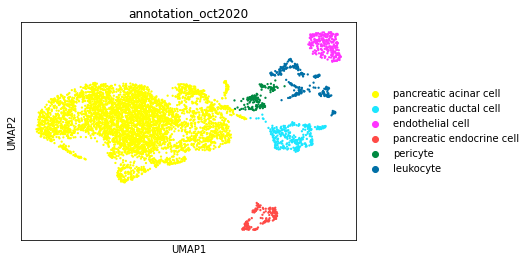

<IPython.core.display.Javascript object>

In [128]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# create Leukocyte subcluster
This is just an example once the celltype annotations are done, how to subcluster cells in a celltype

In [129]:
celltype = "leukocyte"
sub_organ_adata = organ_adata[organ_adata.obs["annotation_oct2020"] == celltype]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


<IPython.core.display.Javascript object>

In [130]:
# sc.pp.filter_genes(sub_organ_adata, min_cells=3)
# sc.pp.normalize_total(sub_organ_adata, target_sum=1e4)
# sc.pp.log1p(sub_organ_adata)
# sc.pp.highly_variable_genes(sub_organ_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
# sub_organ_adata = sub_organ_adata[:, sub_organ_adata.var.highly_variable]
# sc.pp.scale(sub_organ_adata, max_value=10)
# sc.tl.pca(sub_organ_adata, svd_solver='arpack')
# sc.pp.neighbors(sub_organ_adata, n_neighbors=10, n_pcs=40)
# sc.tl.umap(sub_organ_adata)


<IPython.core.display.Javascript object>

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


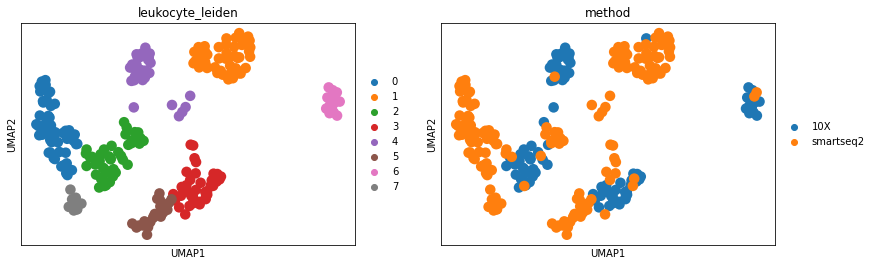

<IPython.core.display.Javascript object>

In [131]:
sc.pp.neighbors(sub_organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(
    sub_organ_adata,
)
sc.tl.leiden(sub_organ_adata, resolution=0.5, key_added="%s_leiden" % celltype)
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype, "method"],
    ncols=3,
)

In [132]:
sc.tl.rank_genes_groups(
    sub_organ_adata, groupby="%s_leiden" % celltype, method="wilcoxon"
)
sub_DE = FormatDE(sub_organ_adata.uns["rank_genes_groups"])

<IPython.core.display.Javascript object>

In [133]:
immune_genes = [
    "MS4A1",
    "CD79A",
    "IGKC",
    "IL32",
    "TRBC2",
    "TRAC",
    "CCL5",
    "CD96",
    "FCN1",
    "FCGR3A",
    "ITGAE",
    "ITGAM",
    "ITGAX",
    "RUNX3",
    "FCGR1A",
    "CX3CR1",
    "MRC1",
    "CD1C",
    "INS",
]

<IPython.core.display.Javascript object>

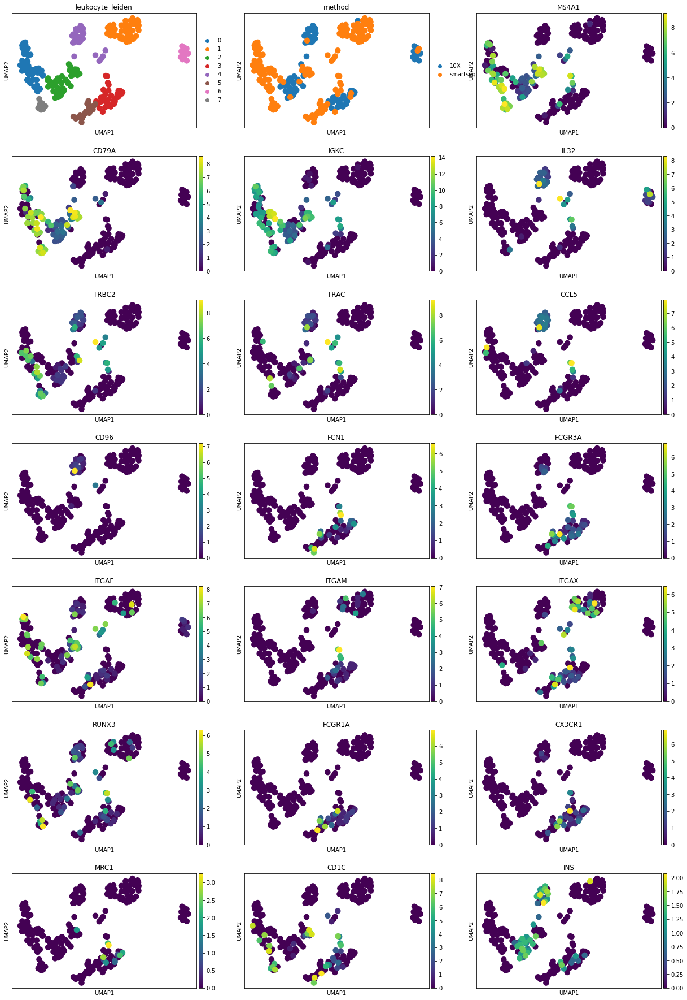

<IPython.core.display.Javascript object>

In [135]:
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype, "method"] + immune_genes,
    ncols=3,
)

0


/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


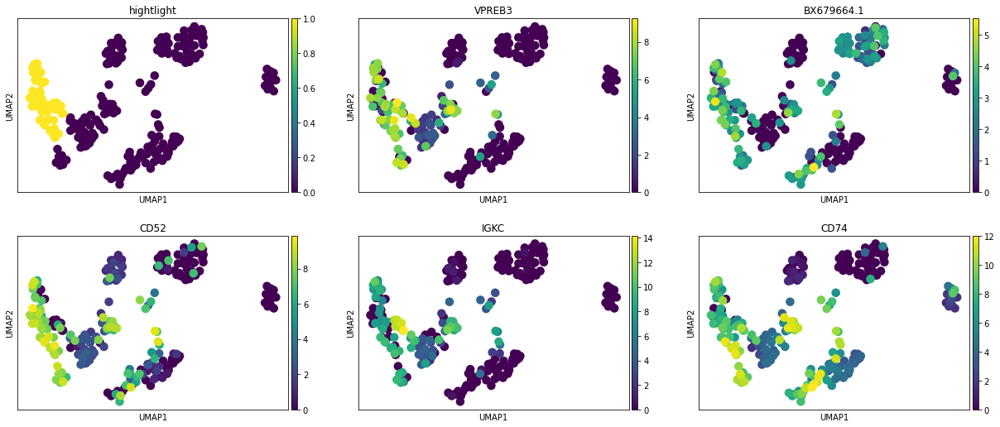

1


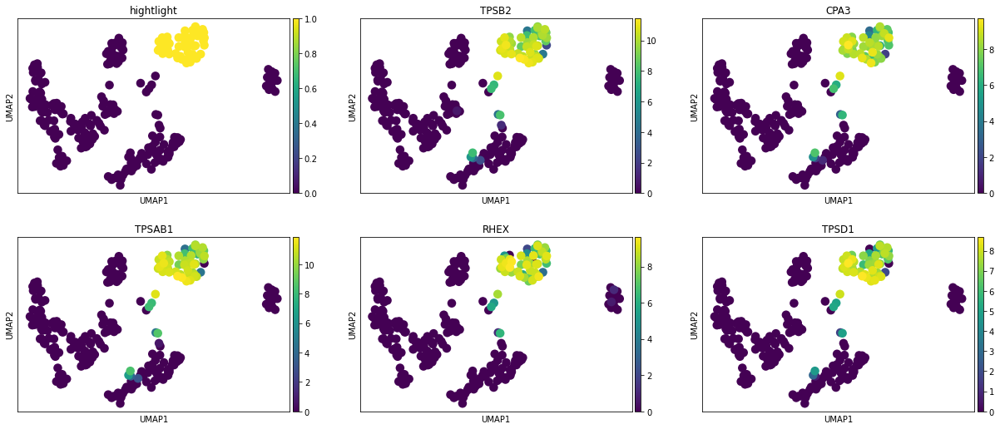

2


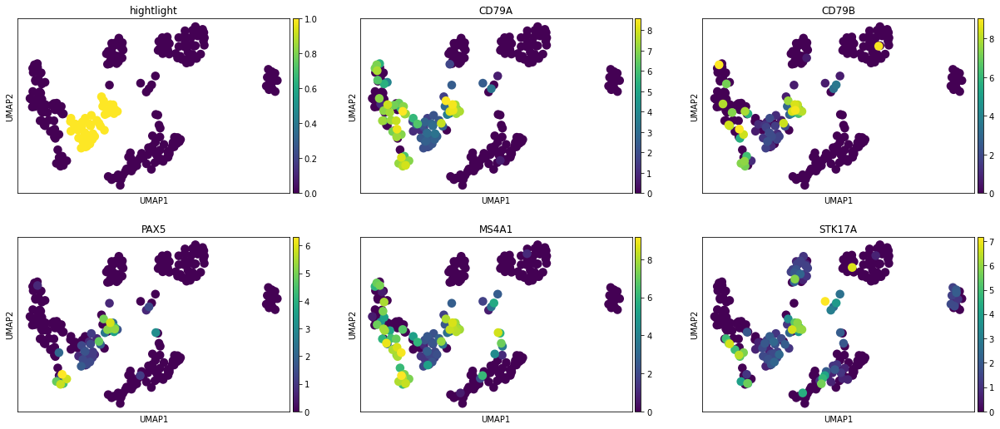

3


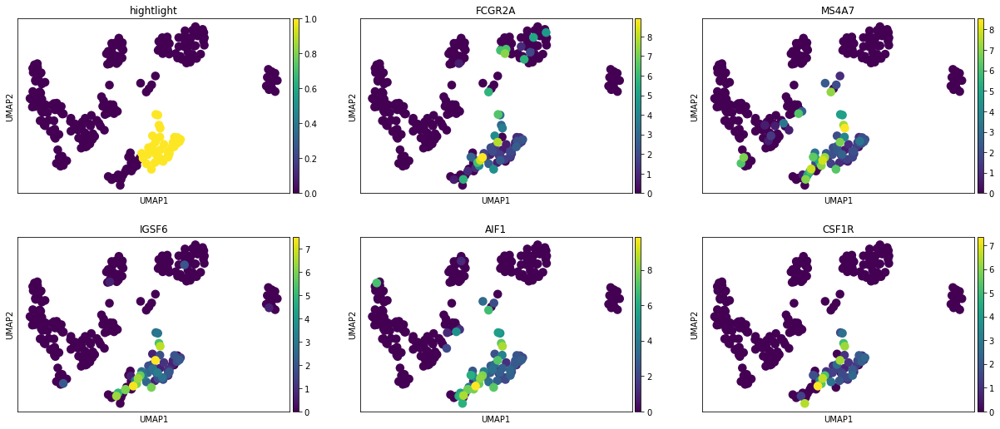

4


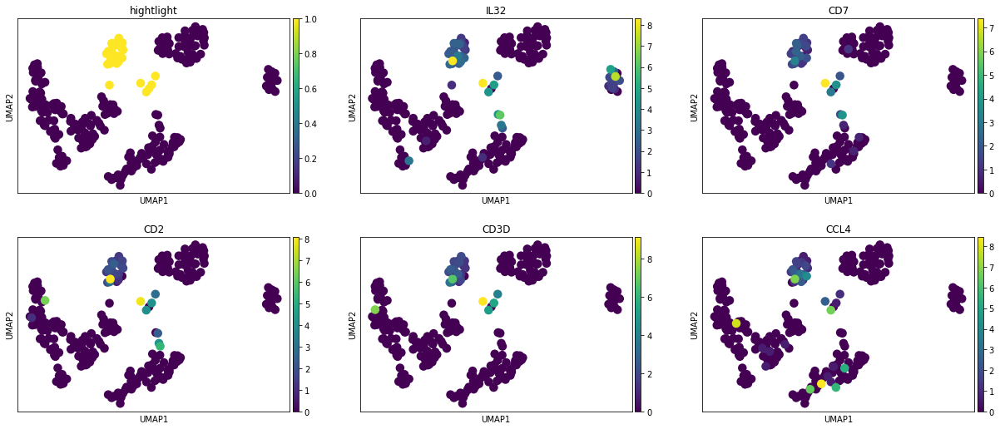

5


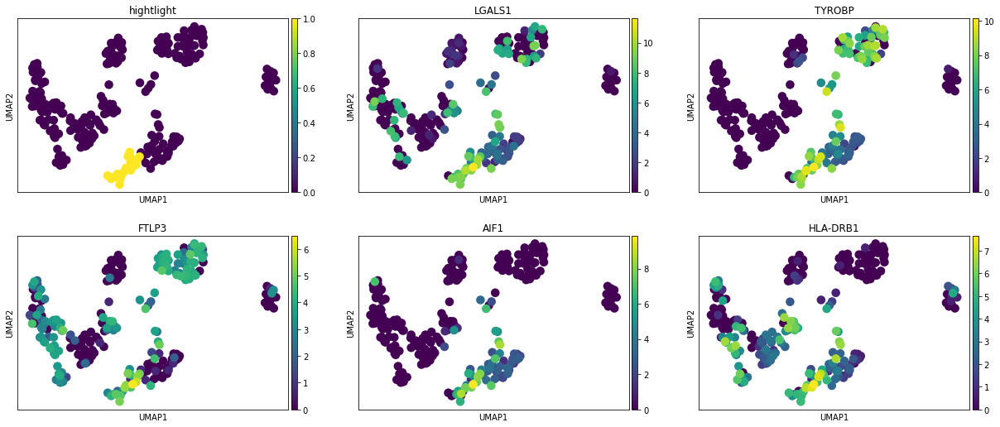

6


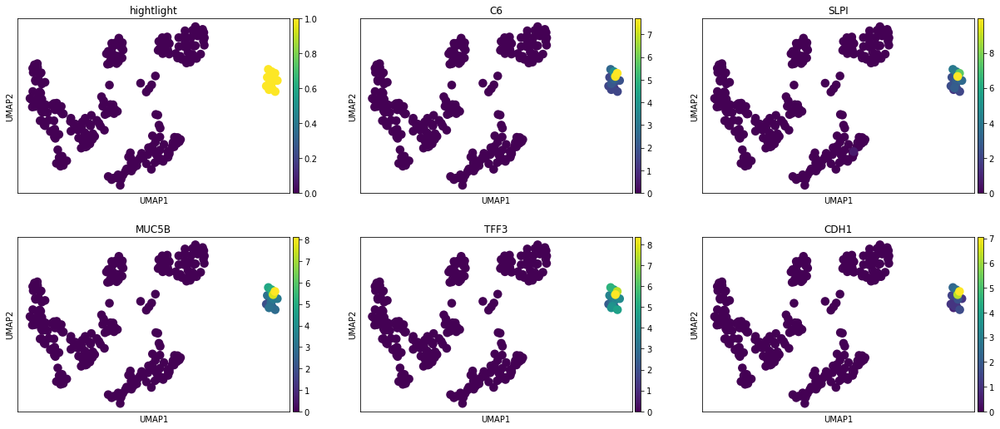

7


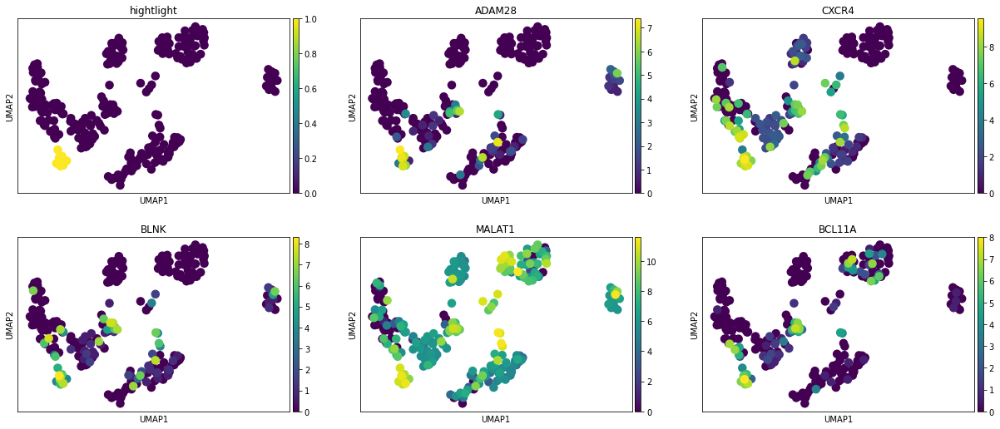

<IPython.core.display.Javascript object>

In [136]:
for x in sub_DE.keys():
    print(x)
    topgenes = list(FilterDE(sub_DE, x)[:5].index)
    sub_organ_adata.obs["hightlight"] = sub_organ_adata.obs["%s_leiden" % celltype] == x
    sc.pl.umap(
        sub_organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

In [142]:
subcluster = {
    "0": "lymphocyte",
    "1": "basophil",  # TPSB2, CPA3
    "2": "B cell",
    "3": "myloid cell",
    "4": "T cell",
    "5": "myloid cell",  # with INS contamination
    "6": "granulocyte",  # TFF3
    "7": "lymphocyte",
}
organ_adata.obs.index = organ_adata.obs.cell_id
organ_adata.obs.annotation_oct2020 = organ_adata.obs.annotation_oct2020.astype(str)
organ_adata.obs.loc[sub_organ_adata.obs["cell_id"], "annotation_oct2020"] = (
    sub_organ_adata.obs["%s_leiden" % celltype].astype(str).values
)
for l in subcluster.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, subcluster[l], inplace=True)

<IPython.core.display.Javascript object>

# create endocrine subcluster

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


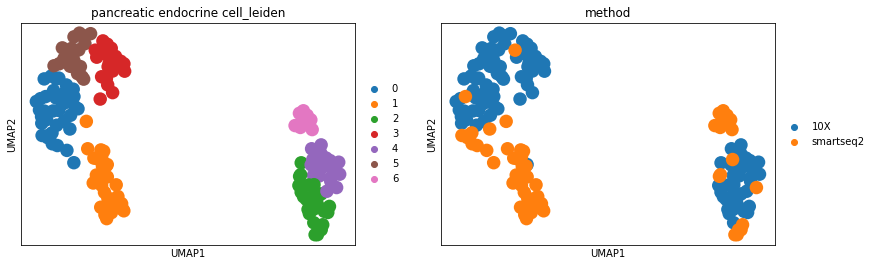

<IPython.core.display.Javascript object>

In [155]:
celltype = "pancreatic endocrine cell"
sub_organ_adata = organ_adata[organ_adata.obs["annotation_oct2020"] == celltype]
sc.pp.neighbors(sub_organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(
    sub_organ_adata,
)
sc.tl.leiden(sub_organ_adata, resolution=1, key_added="%s_leiden" % celltype)
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype, "method"],
    ncols=3,
)

In [156]:
sc.tl.rank_genes_groups(
    sub_organ_adata, groupby="%s_leiden" % celltype, method="wilcoxon"
)
sub_DE = FormatDE(sub_organ_adata.uns["rank_genes_groups"])

<IPython.core.display.Javascript object>

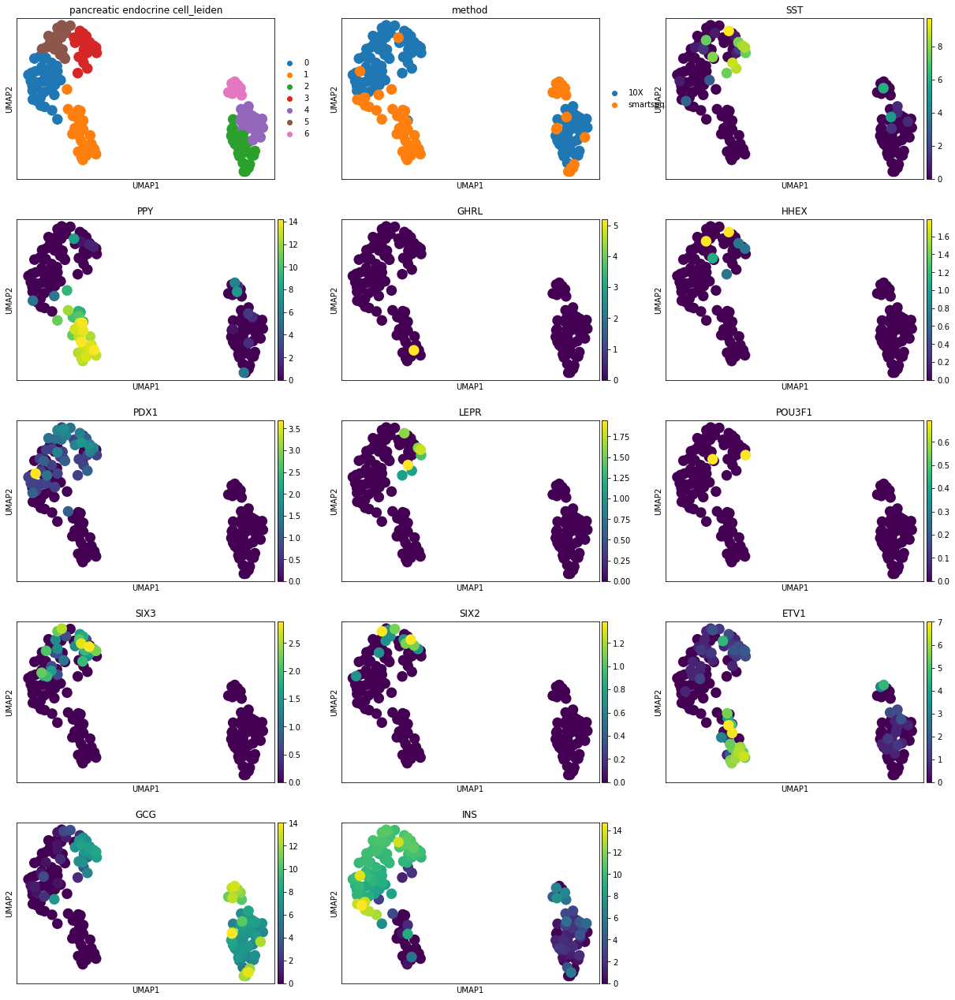

<IPython.core.display.Javascript object>

In [157]:
endocrine_genelist = [
    "SST",
    "PPY",
    "GHRL",
    "HHEX",
    "PDX1",
    "LEPR",
    "POU3F1",
    "SIX3",
    "SIX2",
    "ETV1",
    "GCG",
    "INS",
]
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype, "method"] + endocrine_genelist,
    ncols=3,
)

In [158]:
PrintChildren(
    co,
    "pancreatic endocrine cell",
)

['pancreatic D cell',
 'type B pancreatic cell',
 'pancreatic PP cell',
 'pancreatic A cell']

<IPython.core.display.Javascript object>

In [159]:
subcluster = {
    "0": "type B pancreatic cell",
    "1": "pancreatic PP cell",
    "2": "pancreatic A cell",
    "3": "pancreatic D cell",
    "4": "pancreatic A cell",
    "5": "type B pancreatic cell",
    "6": "pancreatic A cell",
}
organ_adata.obs.index = organ_adata.obs.cell_id
organ_adata.obs.annotation_oct2020 = organ_adata.obs.annotation_oct2020.astype(str)
organ_adata.obs.loc[sub_organ_adata.obs["cell_id"], "annotation_oct2020"] = (
    sub_organ_adata.obs["%s_leiden" % celltype].astype(str).values
)
for l in subcluster.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, subcluster[l], inplace=True)

<IPython.core.display.Javascript object>

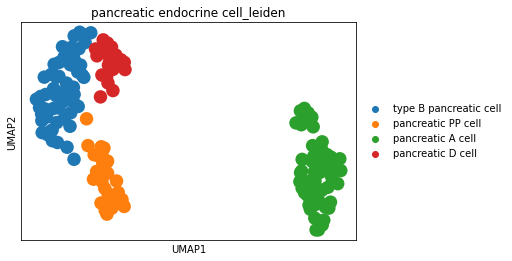

<IPython.core.display.Javascript object>

In [160]:
for l in subcluster.keys():
    sub_organ_adata.obs["%s_leiden" % celltype].replace(l, subcluster[l], inplace=True)

sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype],
    ncols=3,
)

# manually create mapping between cell type and compartment (this is just an example)

In [161]:
np.unique(organ_adata.obs["annotation_oct2020"])

array(['B cell', 'T cell', 'basophil', 'endothelial cell', 'granulocyte',
       'lymphocyte', 'myloid cell', 'pancreatic A cell',
       'pancreatic D cell', 'pancreatic PP cell',
       'pancreatic acinar cell', 'pancreatic ductal cell', 'pericyte',
       'type B pancreatic cell'], dtype=object)

<IPython.core.display.Javascript object>

In [162]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {
    "B cell": "Immune",
    "T cell": "Immune",
    "basophil": "Immune",
    "granulocyte": "Immune",
    "myeloid cell": "Immune",
    "endothelial cell": "Endothelial",
    "lymphocyte": "Immune",
    "myeloid cell": "Immune",
    "pancreatic A cell": "Epithelial",
    "pancreatic D cell": "Epithelial",
    "pancreatic PP cell": "Epithelial",
    "pancreatic acinar cell": "Epithelial",
    "pancreatic ductal cell": "Epithelial",
    "type B pancreatic cell": "Epithelial",
    "leukocyte": "Immune",
    "pericyte cell": "Stromal",
}

<IPython.core.display.Javascript object>

This cell will automatically replace the leiden cluster names with cell type annotations

In [163]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

<IPython.core.display.Javascript object>

# Visualize the results of the new compartment splitting

... storing 'annotation_oct2020' as categorical
... storing 'compartment_oct2020' as categorical


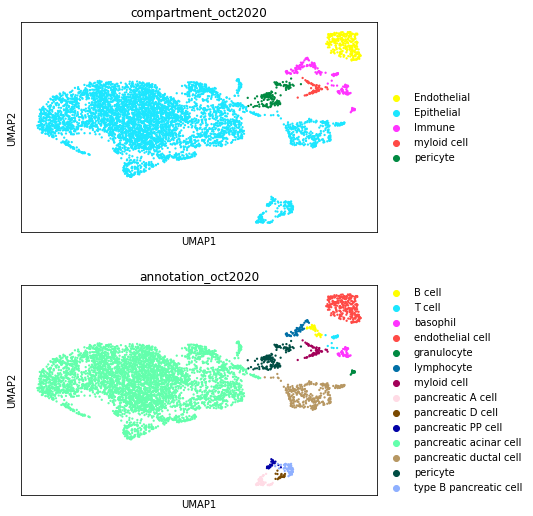

<IPython.core.display.Javascript object>

In [164]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020", "annotation_oct2020"],
    ncols=1,
)

# save data

In [168]:
organ_adata.obs.index.name = None

<IPython.core.display.Javascript object>

In [169]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


<IPython.core.display.Javascript object>